# ISB Data Mining (Student_Prediction)
## Assessment of Learning Process (ALP)

1. Perform data preparations to clean data
2. Exploratory Data Analysis (explore the distributions and characteristics of the columns and compare variables to view their behavior and relationships)
3. Cluster the data using K-Means, Hierarchical Clustering
4. Create a prediction model using any classification algorithm and compare the results
5. Submit your result through Github with the code run and showing results

# Import Library

In [1]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import statistics
import xgboost as xgb
import seaborn as sns
from matplotlib import ticker
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from kneed import KneeLocator
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB

# Data Cleaning and preparation

In [2]:
# Read CSV
url = "data.csv"
df = pd.read_csv(url, sep = ";")
df.head()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4424 entries, 0 to 4423
Data columns (total 37 columns):
 #   Column                                          Non-Null Count  Dtype  
---  ------                                          --------------  -----  
 0   Marital status                                  4424 non-null   int64  
 1   Application mode                                4424 non-null   int64  
 2   Application order                               4424 non-null   int64  
 3   Course                                          4424 non-null   int64  
 4   Daytime/evening attendance	                     4424 non-null   int64  
 5   Previous qualification                          4424 non-null   int64  
 6   Previous qualification (grade)                  4424 non-null   float64
 7   Nacionality                                     4424 non-null   int64  
 8   Mother's qualification                          4424 non-null   int64  
 9   Father's qualification                   

In [4]:
df.shape

(4424, 37)

In [5]:
#Missing values
df.isnull().sum()

Marital status                                    0
Application mode                                  0
Application order                                 0
Course                                            0
Daytime/evening attendance\t                      0
Previous qualification                            0
Previous qualification (grade)                    0
Nacionality                                       0
Mother's qualification                            0
Father's qualification                            0
Mother's occupation                               0
Father's occupation                               0
Admission grade                                   0
Displaced                                         0
Educational special needs                         0
Debtor                                            0
Tuition fees up to date                           0
Gender                                            0
Scholarship holder                                0
Age at enrol

In [6]:
#Check Dupe
df.duplicated().sum()

0

In [7]:
# Check the Number of Unique Values in Each Column
df.nunique()

Marital status                                      6
Application mode                                   18
Application order                                   8
Course                                             17
Daytime/evening attendance\t                        2
Previous qualification                             17
Previous qualification (grade)                    101
Nacionality                                        21
Mother's qualification                             29
Father's qualification                             34
Mother's occupation                                32
Father's occupation                                46
Admission grade                                   620
Displaced                                           2
Educational special needs                           2
Debtor                                              2
Tuition fees up to date                             2
Gender                                              2
Scholarship holder          

In [8]:
print(df.columns)

Index(['Marital status', 'Application mode', 'Application order', 'Course',
       'Daytime/evening attendance\t', 'Previous qualification',
       'Previous qualification (grade)', 'Nacionality',
       'Mother's qualification', 'Father's qualification',
       'Mother's occupation', 'Father's occupation', 'Admission grade',
       'Displaced', 'Educational special needs', 'Debtor',
       'Tuition fees up to date', 'Gender', 'Scholarship holder',
       'Age at enrollment', 'International',
       'Curricular units 1st sem (credited)',
       'Curricular units 1st sem (enrolled)',
       'Curricular units 1st sem (evaluations)',
       'Curricular units 1st sem (approved)',
       'Curricular units 1st sem (grade)',
       'Curricular units 1st sem (without evaluations)',
       'Curricular units 2nd sem (credited)',
       'Curricular units 2nd sem (enrolled)',
       'Curricular units 2nd sem (evaluations)',
       'Curricular units 2nd sem (approved)',
       'Curricular units 2nd

In [9]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Marital status,4424.0,1.178571,0.605747,1.00,1.00,1.000000,1.000000,6.000000
Application mode,4424.0,18.669078,17.484682,1.00,1.00,17.000000,39.000000,57.000000
Application order,4424.0,1.727848,1.313793,0.00,1.00,1.000000,2.000000,9.000000
Course,4424.0,8856.642631,2063.566416,33.00,9085.00,9238.000000,9556.000000,9991.000000
Daytime/evening attendance\t,4424.0,0.890823,0.311897,0.00,1.00,1.000000,1.000000,1.000000
Previous qualification,4424.0,4.577758,10.216592,1.00,1.00,1.000000,1.000000,43.000000
Previous qualification (grade),4424.0,132.613314,13.188332,95.00,125.00,133.100000,140.000000,190.000000
Nacionality,4424.0,1.873192,6.914514,1.00,1.00,1.000000,1.000000,109.000000
Mother's qualification,4424.0,19.561935,15.603186,1.00,2.00,19.000000,37.000000,44.000000
Father's qualification,4424.0,22.275316,15.343108,1.00,3.00,19.000000,37.000000,44.000000


C:\Users\User\AppData\Roaming\Python\Python39\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


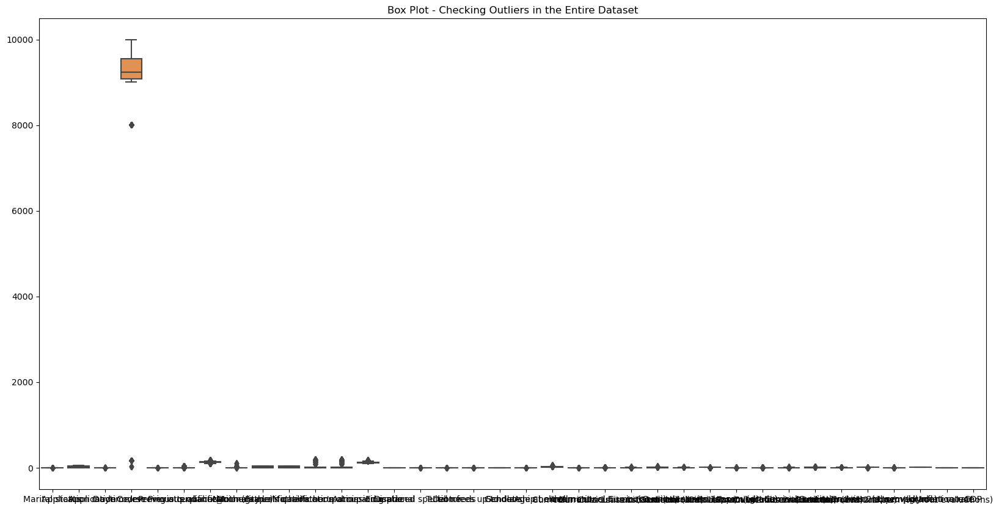

In [10]:
plt.figure(figsize=(20, 10))
sns.boxplot(data=df)
plt.title('Box Plot - Checking Outliers in the Entire Dataset')
plt.show()

C:\Users\User\AppData\Local\Temp\ipykernel_11136\2027630705.py:18: UserWarning: Glyph 9 (	) missing from current font.
  plt.tight_layout()
C:\Users\User\AppData\Roaming\Python\Python39\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


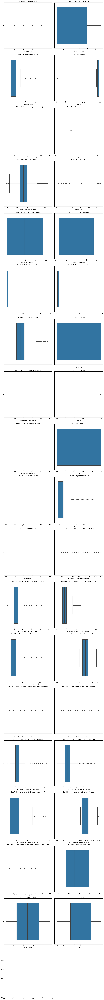

In [11]:
column_names = df.columns

num_features = len(column_names)
num_rows = (num_features + 1) // 2
num_cols = 2

fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 6 * num_rows))
axes = axes.flatten()

for i, column in enumerate(column_names):
    if df[column].dtype in ['int64', 'float64']: 
        sns.boxplot(x=df[column], ax=axes[i])
        axes[i].set_title(f'Box Plot - {column}')

if num_features % 2 != 0:
    fig.delaxes(axes[-1])

plt.tight_layout()
plt.show()

# Exploratory Data Analysis(EDA)

In [12]:
df.describe()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP
count,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,...,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000
mean,1.178571,18.669078,1.727848,8856.642631,0.890823,4.577758,132.613314,1.873192,19.561935,22.275316,...,0.137658,0.541817,6.232143,8.063291,4.435805,10.230206,0.150316,11.566139,1.228029,0.001969
std,0.605747,17.484682,1.313793,2063.566416,0.311897,10.216592,13.188332,6.914514,15.603186,15.343108,...,0.690880,1.918546,2.195951,3.947951,3.014764,5.210808,0.753774,2.663850,1.382711,2.269935
min,1.000000,1.000000,0.000000,33.000000,0.000000,1.000000,95.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.600000,-0.800000,-4.060000
25%,1.000000,1.000000,1.000000,9085.000000,1.000000,1.000000,125.000000,1.000000,2.000000,3.000000,...,0.000000,0.000000,5.000000,6.000000,2.000000,10.750000,0.000000,9.400000,0.300000,-1.700000
50%,1.000000,17.000000,1.000000,9238.000000,1.000000,1.000000,133.100000,1.000000,19.000000,19.000000,...,0.000000,0.000000,6.000000,8.000000,5.000000,12.200000,0.000000,11.100000,1.400000,0.320000
75%,1.000000,39.000000,2.000000,9556.000000,1.000000,1.000000,140.000000,1.000000,37.000000,37.000000,...,0.000000,0.000000,7.000000,10.000000,6.000000,13.333333,0.000000,13.900000,2.600000,1.790000
max,6.000000,57.000000,9.000000,9991.000000,1.000000,43.000000,190.000000,109.000000,44.000000,44.000000,...,12.000000,19.000000,23.000000,33.000000,20.000000,18.571429,12.000000,16.200000,3.700000,3.510000


C:\Users\User\AppData\Roaming\Python\Python39\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


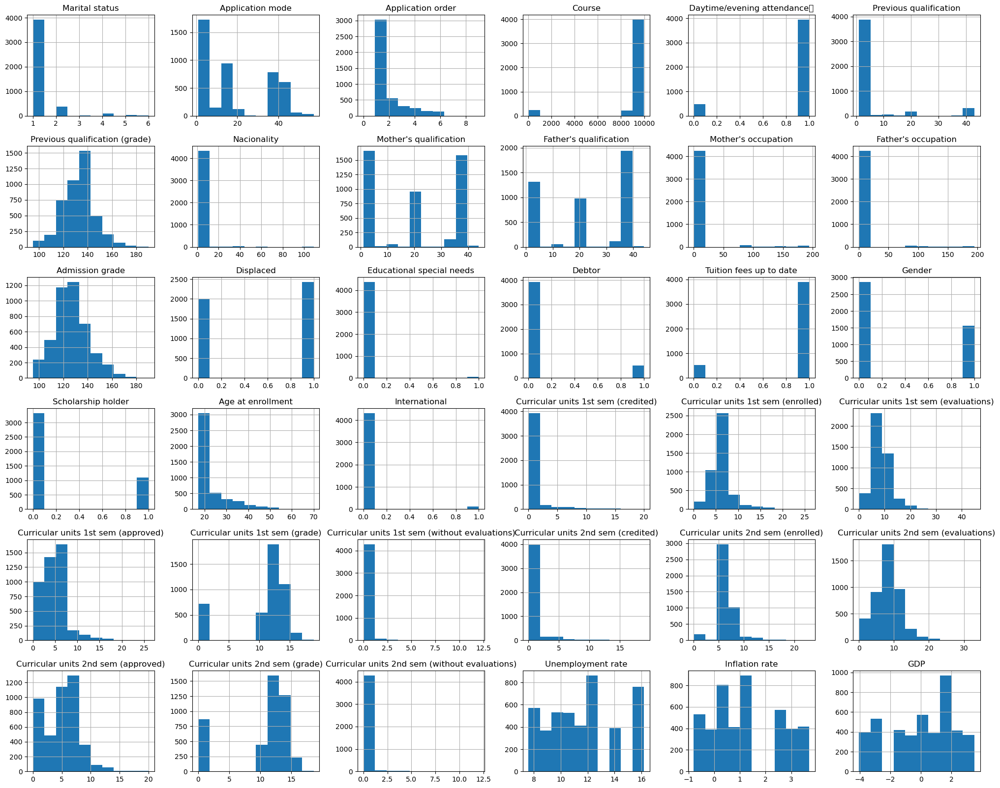

In [13]:
df.hist(figsize=(25,20))
plt.show()

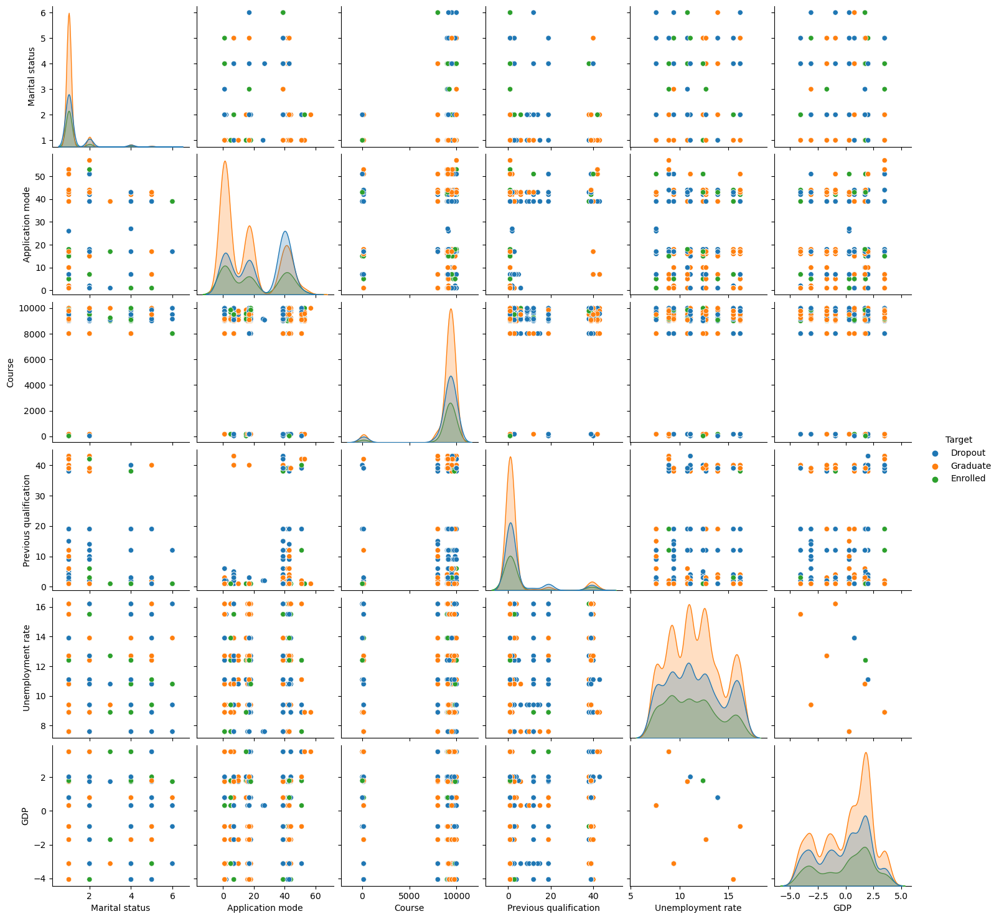

In [14]:
selected_columns = ['Marital status', 'Application mode', 'Course', 'Previous qualification', 'Unemployment rate', 'GDP', 'Target']

sns.pairplot(df[selected_columns], hue='Target')
plt.show()

In [15]:
plt.figure(1, figsize=(35,20))
sns.pairplot(df, hue='Target', height=2)
plt.show()

C:\Users\User\anaconda3\lib\site-packages\seaborn\axisgrid.py:88: UserWarning: Glyph 9 (	) missing from current font.
  self._figure.tight_layout(*args, **kwargs)
C:\Users\User\anaconda3\lib\site-packages\seaborn\utils.py:95: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.draw()
C:\Users\User\anaconda3\lib\site-packages\seaborn\axisgrid.py:88: UserWarning: Glyph 9 (	) missing from current font.
  self._figure.tight_layout(*args, **kwargs)


<Figure size 3500x2000 with 0 Axes>

C:\Users\User\AppData\Roaming\Python\Python39\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


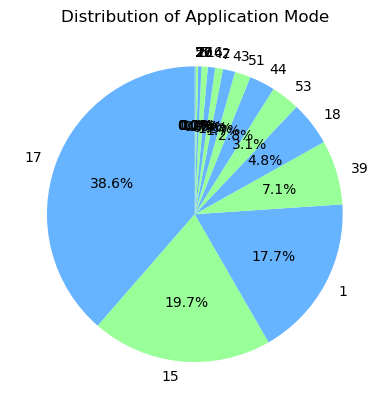

In [16]:
plt.pie(df['Application mode'].value_counts(), labels=df['Application mode'].unique(), autopct='%1.1f%%', startangle=90, colors=['#66b3ff','#99ff99'])
plt.title('Distribution of Application Mode')
plt.show()

C:\Users\User\anaconda3\lib\site-packages\seaborn\utils.py:95: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.draw()
C:\Users\User\anaconda3\lib\site-packages\seaborn\utils.py:660: UserWarning: Glyph 9 (	) missing from current font.
  bboxes = [l.get_window_extent() for l in labels]


<AxesSubplot:>

C:\Users\User\AppData\Roaming\Python\Python39\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


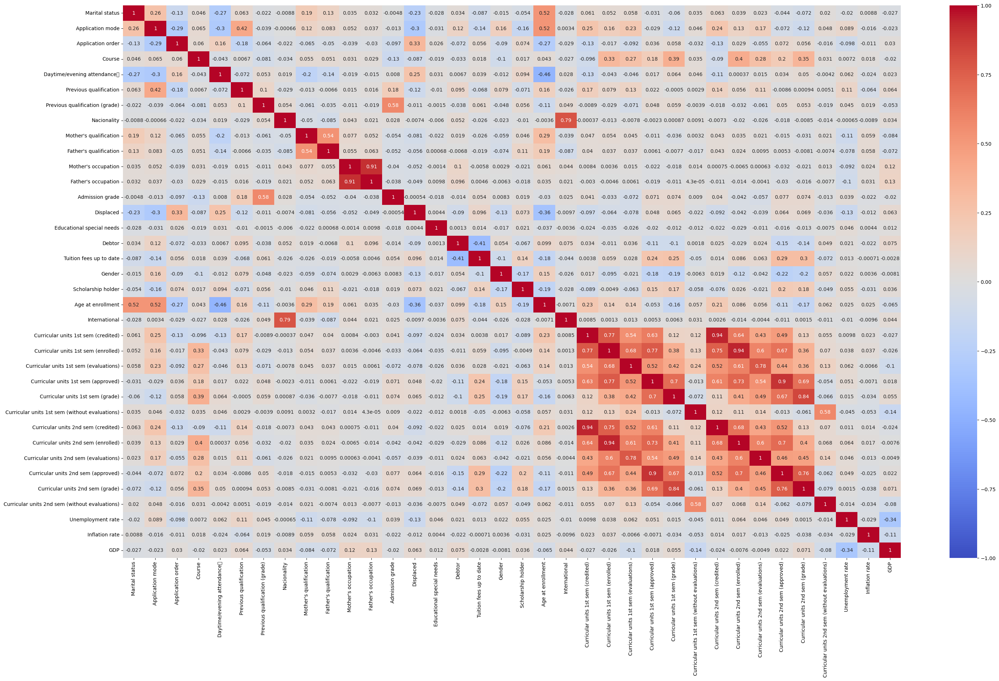

In [17]:
corr_matrix=df.corr()
plt.figure(1, figsize=(35,20))
sns.heatmap(corr_matrix, cmap='coolwarm', center=0, annot=True, vmin=-1, vmax=1)

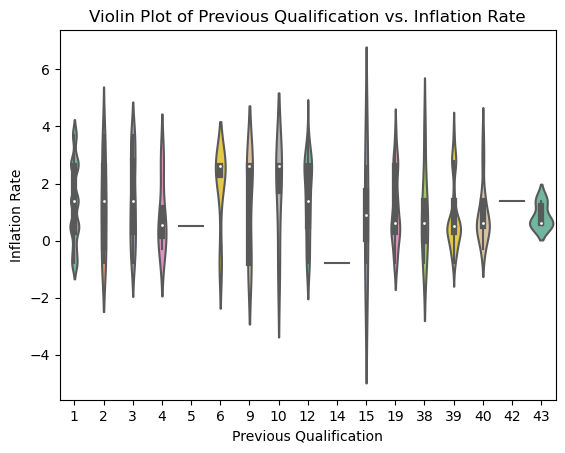

In [18]:
sns.violinplot(x='Previous qualification', y='Inflation rate', data=df, palette='Set2')
plt.title('Violin Plot of Previous Qualification vs. Inflation Rate')
plt.xlabel('Previous Qualification')
plt.ylabel('Inflation Rate')
plt.show()

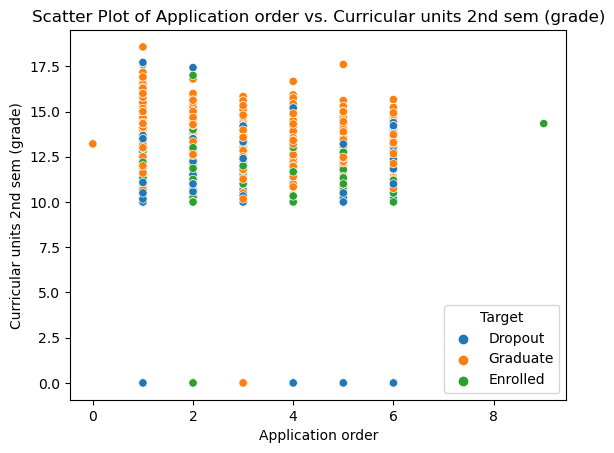

In [19]:
sns.scatterplot(x='Application order', y='Curricular units 2nd sem (grade)', hue='Target', data=df)
plt.title('Scatter Plot of Application order vs. Curricular units 2nd sem (grade)')
plt.show()

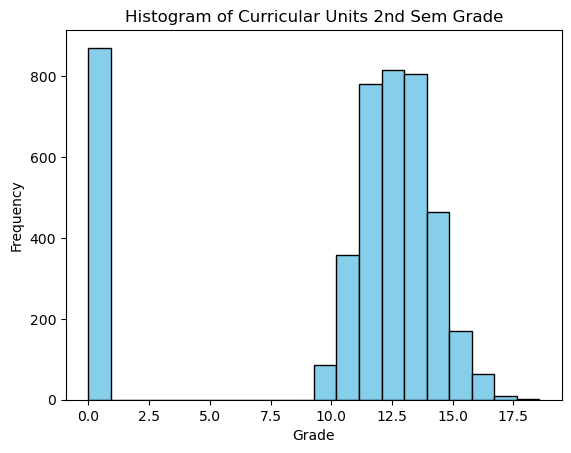

In [20]:
#Histogram of Curricular Units 2nd Sem Grade
plt.hist(df['Curricular units 2nd sem (grade)'], bins=20, color='skyblue', edgecolor='black')
plt.title('Histogram of Curricular Units 2nd Sem Grade')
plt.xlabel('Grade')
plt.ylabel('Frequency')
plt.show()

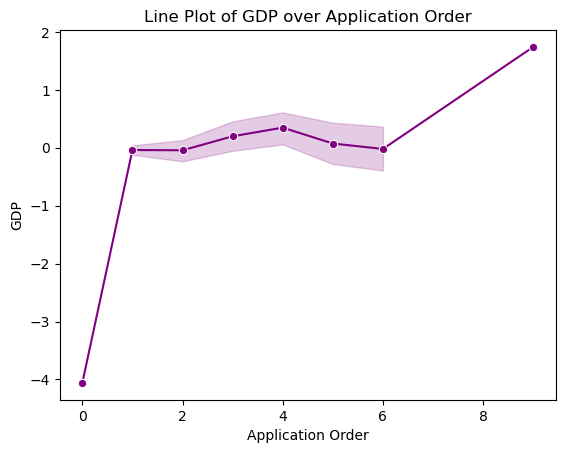

In [21]:
#Line plot for GDP over Application Order
sns.lineplot(x='Application order', y='GDP', data=df, marker='o', color='purple')
plt.title('Line Plot of GDP over Application Order')
plt.xlabel('Application Order')
plt.ylabel('GDP')
plt.show()

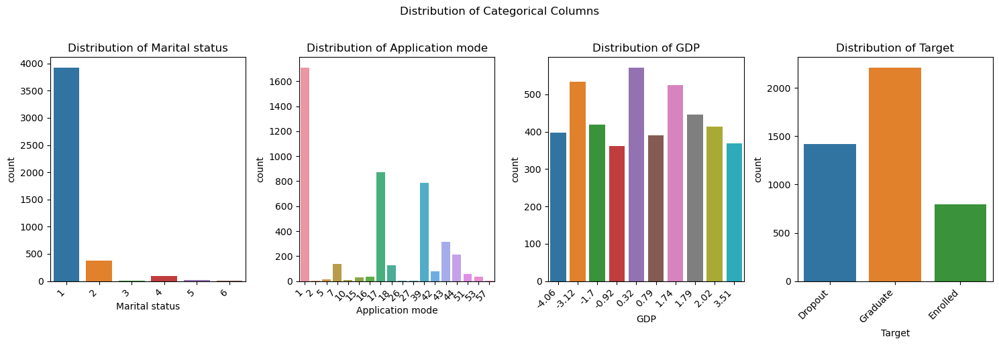

In [22]:
categorical_columns = ['Marital status', 'Application mode', 'GDP','Target']

fig, axes = plt.subplots(nrows=1, ncols=len(categorical_columns), figsize=(15, 5))
fig.suptitle('Distribution of Categorical Columns', y=1.02)

if len(categorical_columns) == 1:
    axes = [axes]

for i, col in enumerate(categorical_columns):
    sns.countplot(x=col, data=df, ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')
    axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45, horizontalalignment='right')

plt.tight_layout()
plt.show()

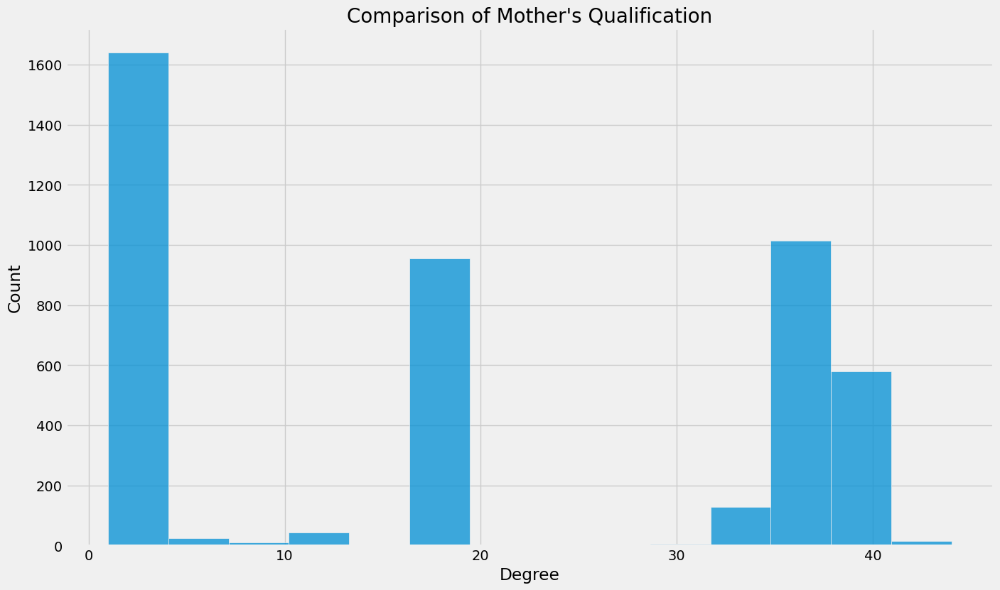

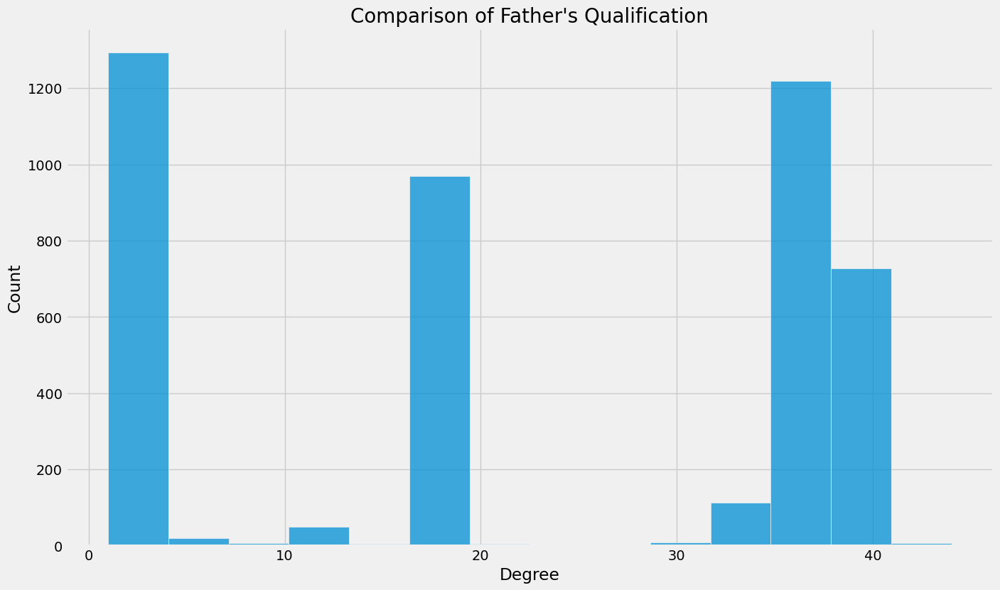

In [23]:
plt.rcParams['figure.figsize'] = (15, 9)
plt.style.use('fivethirtyeight')
df.columns = df.columns.str.strip()

sns.histplot(df["Mother's qualification"], palette='Pastel1')
plt.title("Comparison of Mother's Qualification", fontweight=30, fontsize=20)
plt.xlabel('Degree')
plt.ylabel('Count')
plt.show()

plt.rcParams['figure.figsize'] = (15, 9)
plt.style.use('fivethirtyeight')
df.columns = df.columns.str.strip()

sns.histplot(df["Father's qualification"], palette='Pastel2')
plt.title("Comparison of Father's Qualification", fontweight=30, fontsize=20)
plt.xlabel('Degree')
plt.ylabel('Count')
plt.show()

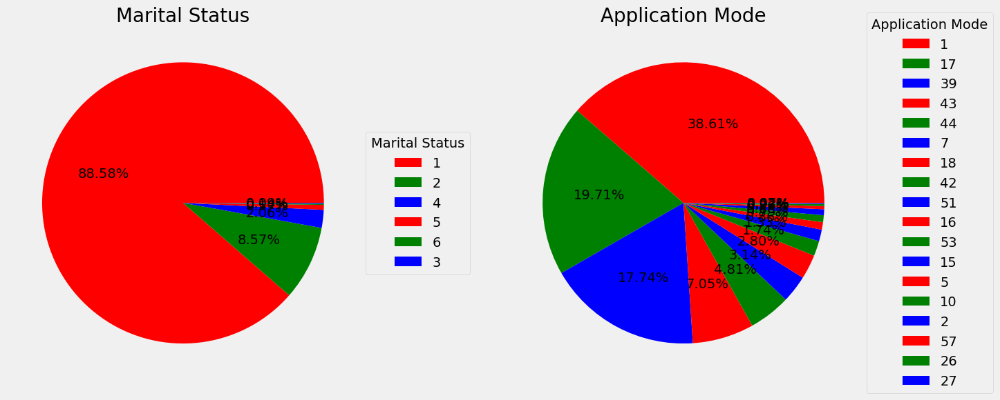

In [24]:
plt.rcParams['figure.figsize'] = (20, 20)

plt.subplot(2, 3, 1)
size = df['Marital status'].value_counts()
colors = ['red', 'green', 'blue']
labels = size.index  # Add this line to define labels
plt.pie(size, colors=colors, autopct='%.2f%%')
plt.title('Marital Status', fontsize=20)
plt.axis('off')
plt.legend(labels, title="Marital Status", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

plt.subplot(2, 3, 2)
size = df['Application mode'].value_counts()
colors = ['red', 'green', 'blue']
labels = size.index  # Add this line to define labels
plt.pie(size, colors=colors, autopct='%.2f%%')
plt.title('Application Mode', fontsize=20)
plt.axis('off')
plt.legend(labels, title="Application Mode", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

plt.tight_layout()
plt.show()

Two pie charts side by side, each representing the distribution of a categorical variable in this dataset. The percentage values are shown inside the pie charts, and legends provide additional information about the categories. Adjustments can be made based on specific dataset and visualization preferences.

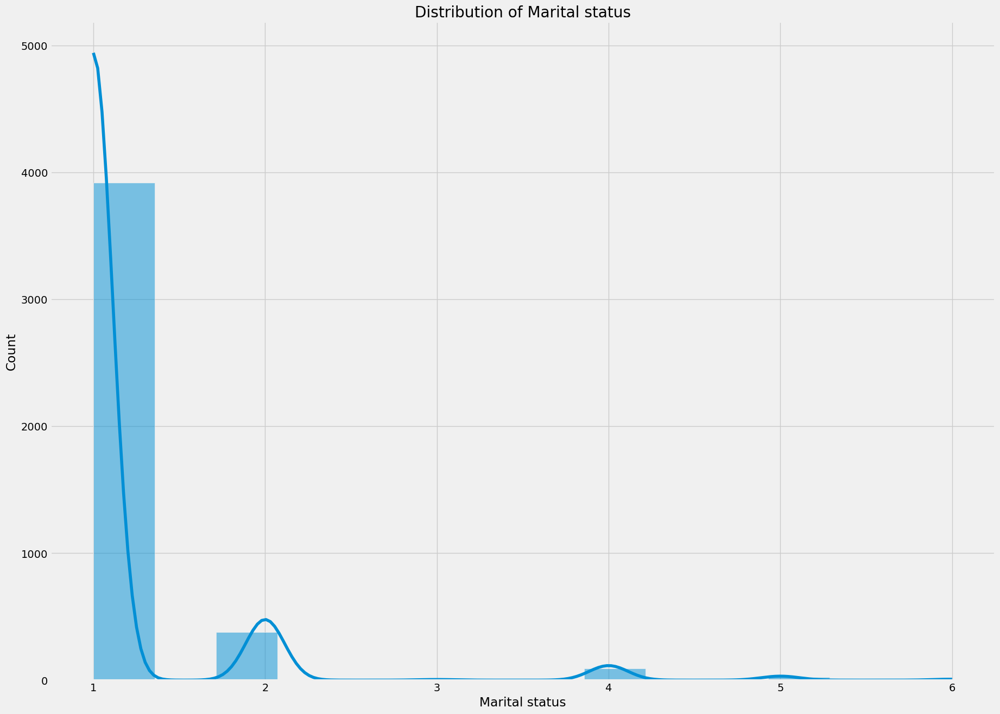

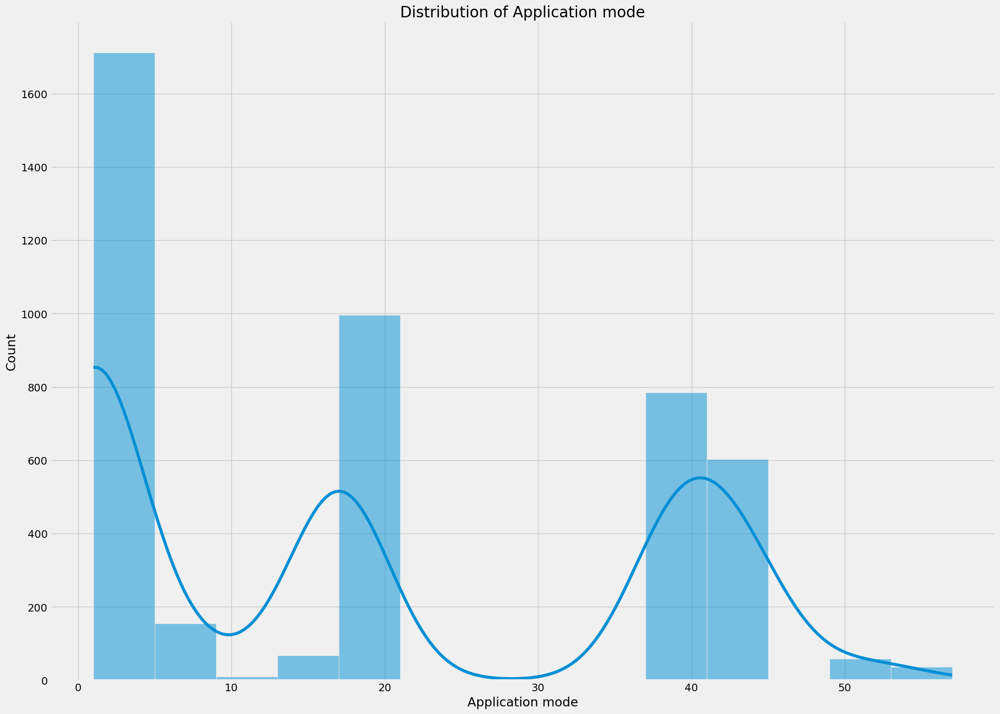

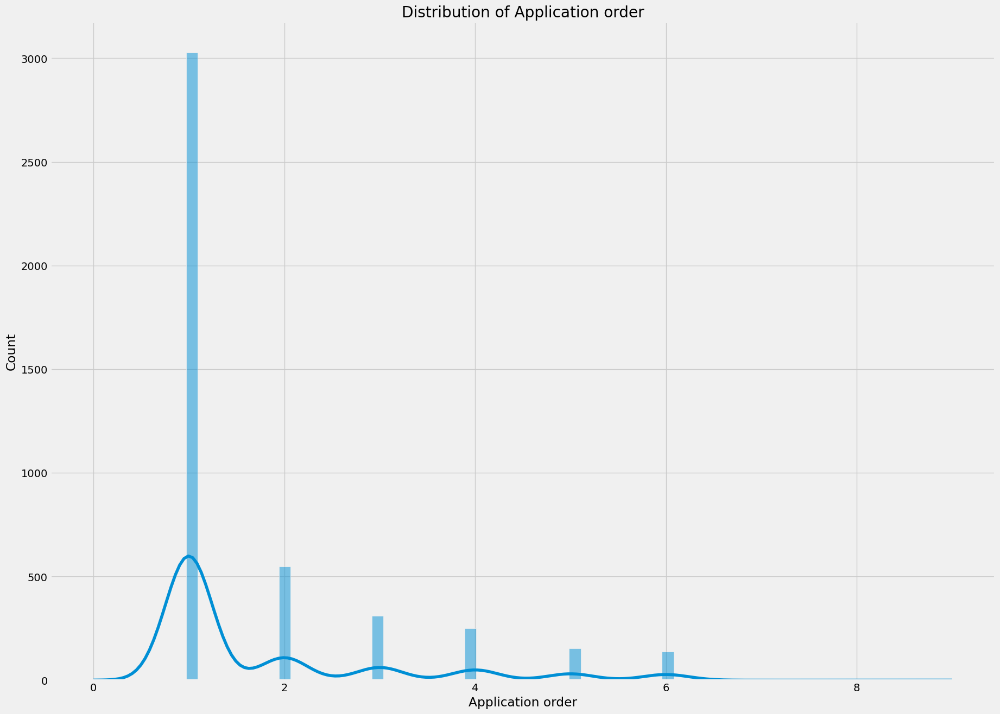

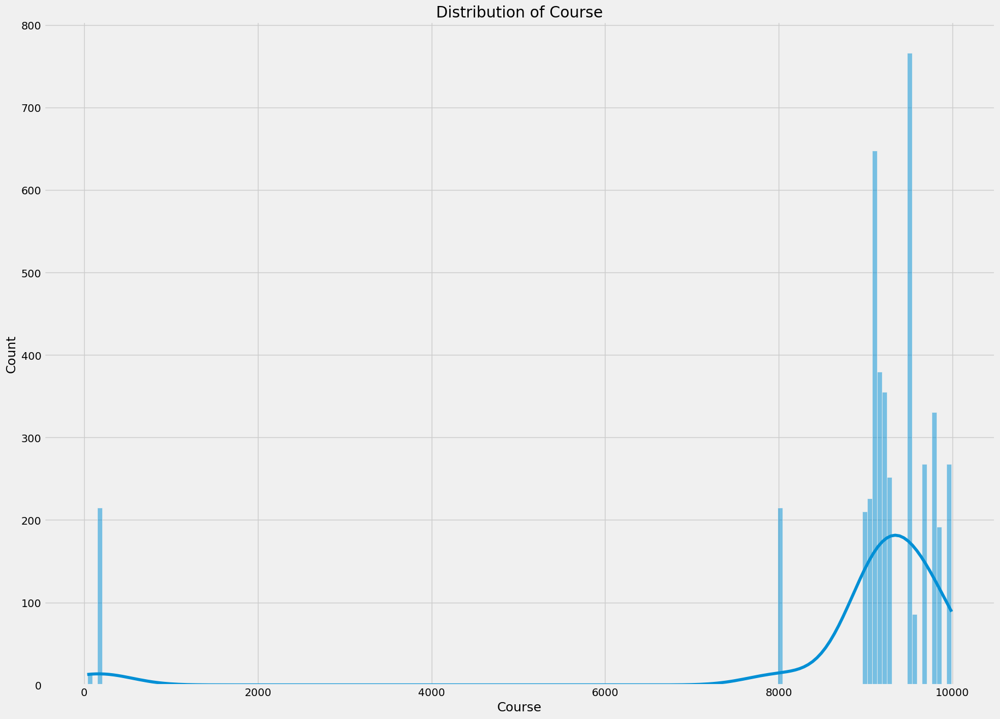

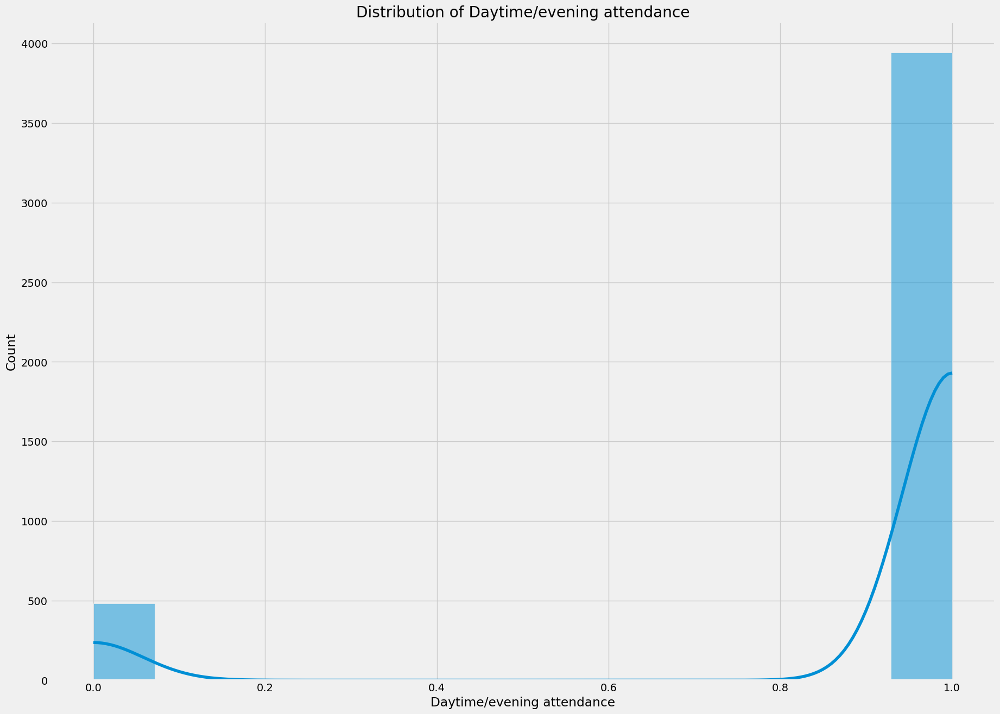

...

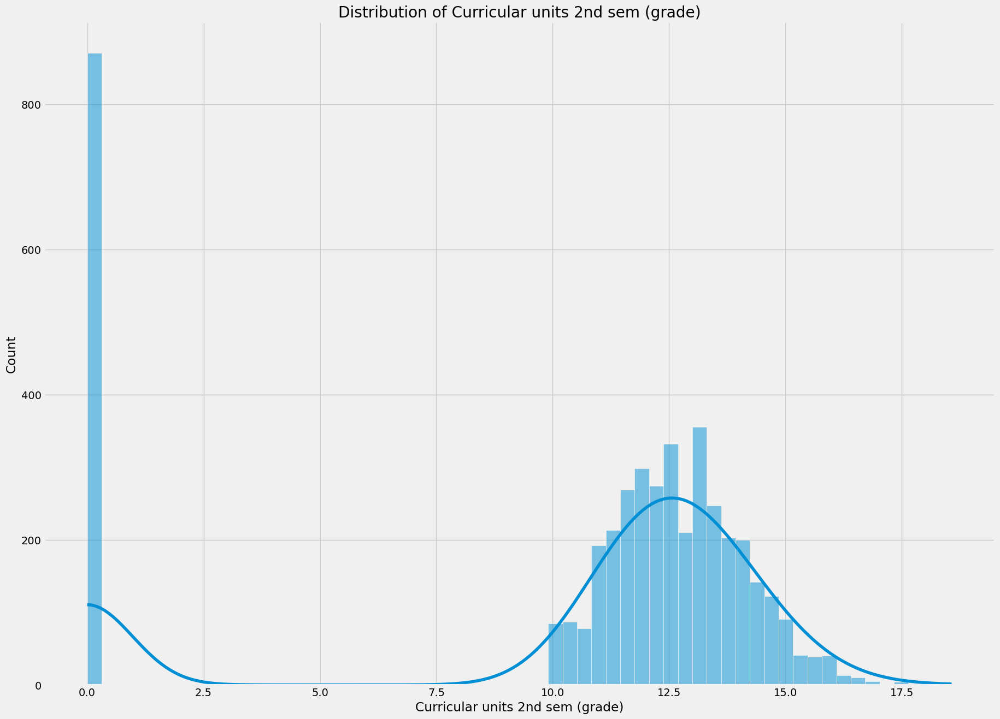

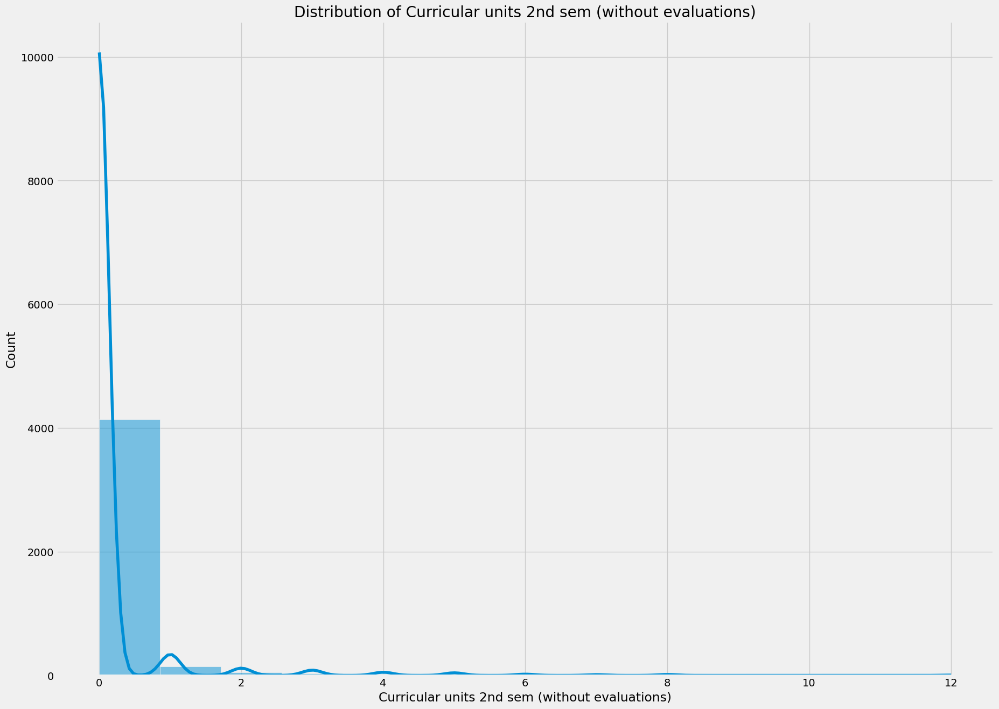

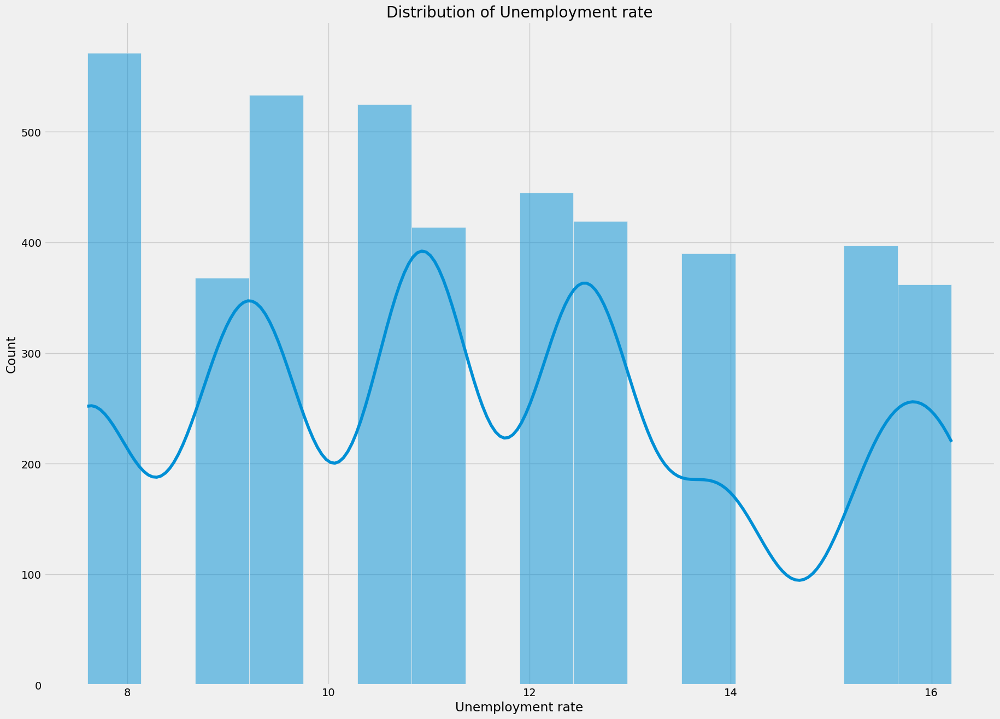

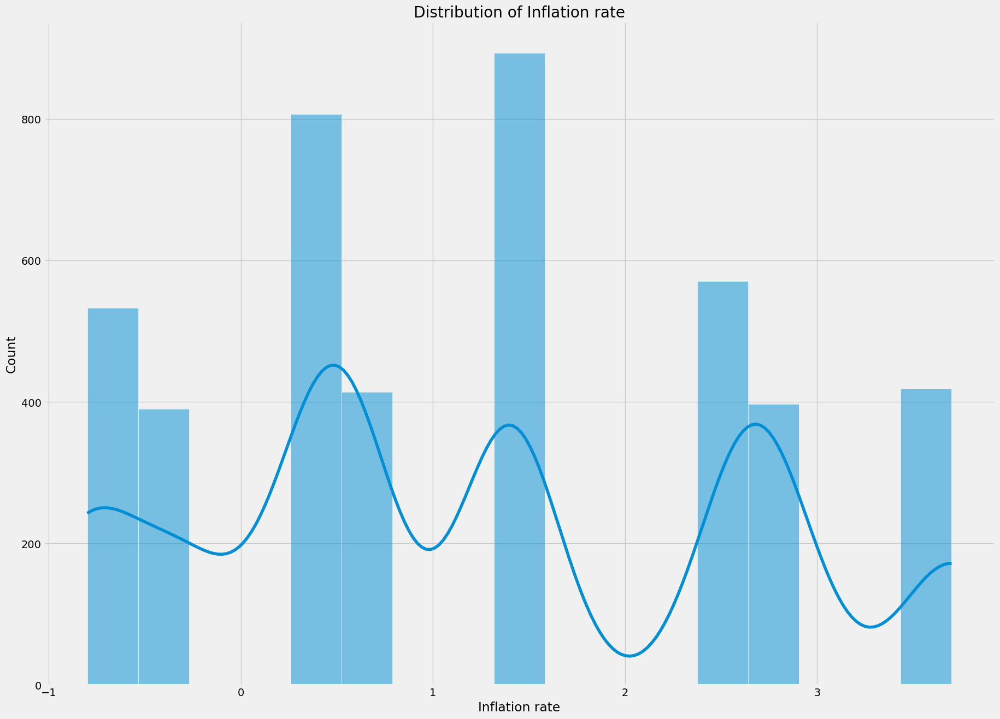

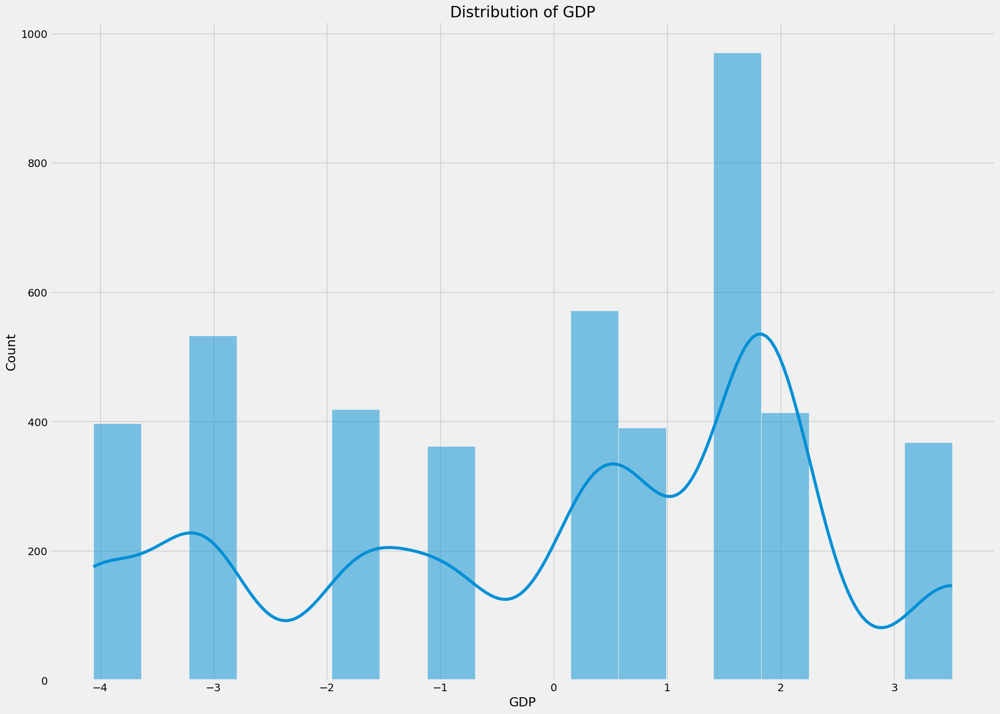

In [25]:
numerical_columns = df.select_dtypes(include='number').columns

for column in numerical_columns:
    plt.figure(figsize=(20, 15))
    sns.histplot(df[column], kde=True)
    plt.title(f'Distribution of {column}')
    plt.show()

Enrolled: 2209
Dropout: 1421
Graduate: 794


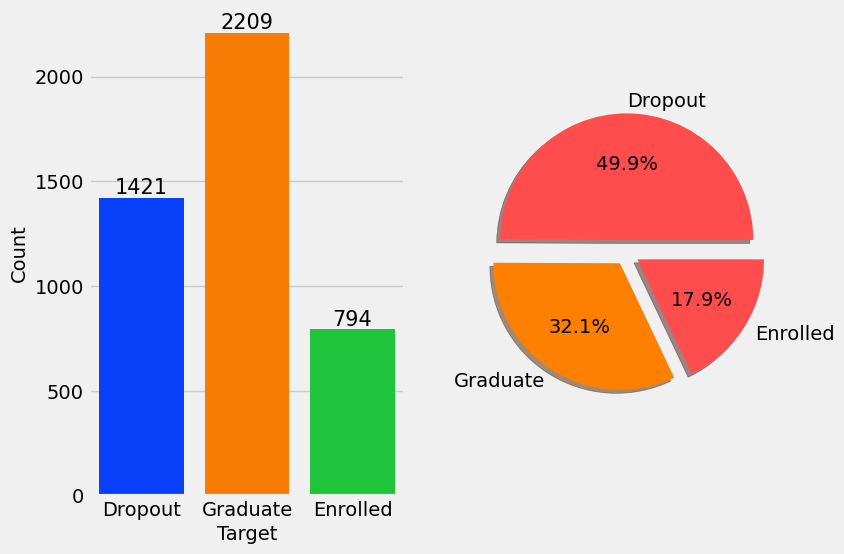

In [26]:
f, ax = plt.subplots(1, 2, figsize=(8, 6))

sns.countplot(x=df['Target'], data=df, palette='bright', ax=ax[0], saturation=0.95)
for container in ax[0].containers:
    ax[0].bar_label(container, color='black', size=15)

ax[0].set_xlabel('Target', fontsize=14)
ax[0].set_ylabel('Count', fontsize=14)
ax[0].tick_params(labelsize=14)

unique_values = df['Target'].unique()
explode_values = [0.1] * len(unique_values)  

plt.pie(x=df['Target'].value_counts(), labels=unique_values, explode=explode_values,
        autopct='%1.1f%%', shadow=True, colors=['#ff4d4d', '#ff8000'], textprops={'fontsize': 14})

M, N, D = df['Target'].value_counts()
print('Enrolled:', M)
print('Dropout:', N)
print('Graduate:', D)

plt.show()

In [27]:
df.corr()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP
Marital status,1.000000,0.264006,-0.125854,0.046365,-0.274939,0.062529,-0.022406,-0.008843,0.193163,0.130353,...,0.034711,0.062831,0.039026,0.022784,-0.043739,-0.071506,0.020426,-0.020338,0.008761,-0.027003
Application mode,0.264006,1.000000,-0.286357,0.065385,-0.304092,0.422411,-0.039020,-0.000661,0.118974,0.083276,...,0.045828,0.238445,0.130046,0.167872,-0.071526,-0.115424,0.047983,0.089080,-0.016375,-0.022743
Application order,-0.125854,-0.286357,1.000000,0.059507,0.158657,-0.184315,-0.064484,-0.022416,-0.064956,-0.050288,...,-0.031699,-0.125815,0.028878,-0.055089,0.071793,0.055517,-0.015757,-0.098419,-0.011133,0.030201
Course,0.046365,0.065385,0.059507,1.000000,-0.043151,0.006654,-0.081013,-0.033923,0.054543,0.050724,...,0.034514,-0.089817,0.401539,0.278797,0.198032,0.348728,0.030816,0.007153,0.017710,-0.020265
Daytime/evening attendance,-0.274939,-0.304092,0.158657,-0.043151,1.000000,-0.071871,0.052597,0.018530,-0.204767,-0.139894,...,0.045630,-0.111953,0.000371,0.014610,0.034022,0.050493,-0.004229,0.061974,-0.024043,0.022929
Previous qualification,0.062529,0.422411,-0.184315,0.006654,-0.071871,1.000000,0.104072,-0.029214,-0.013190,-0.006614,...,0.002887,0.143031,0.056179,0.114850,-0.008632,0.000942,0.005102,0.111958,-0.063736,0.064069
Previous qualification (grade),-0.022406,-0.039020,-0.064484,-0.081013,0.052597,0.104072,1.000000,0.054088,-0.060670,-0.035234,...,-0.003926,-0.018489,-0.031649,-0.061355,0.050263,0.053239,-0.019015,0.045222,0.018710,-0.052620
Nacionality,-0.008843,-0.000661,-0.022416,-0.033923,0.018530,-0.029214,0.054088,1.000000,-0.049946,-0.085282,...,0.009145,-0.007278,-0.020113,-0.025721,-0.017880,-0.008497,-0.014041,-0.000651,-0.008922,0.034478
Mother's qualification,0.193163,0.118974,-0.064956,0.054543,-0.204767,-0.013190,-0.060670,-0.049946,1.000000,0.535140,...,0.003183,0.042771,0.035150,0.021033,-0.014858,-0.031175,0.021305,-0.114351,0.059441,-0.083657
Father's qualification,0.130353,0.083276,-0.050288,0.050724,-0.139894,-0.006614,-0.035234,-0.085282,0.535140,1.000000,...,-0.017333,0.042666,0.024380,0.009514,0.005285,-0.008083,-0.007430,-0.077905,0.057633,-0.071610


# Data Preprocessing

In [28]:
df.duplicated().any()

False

In [29]:
print(df.isnull().any())

Marital status                                    False
Application mode                                  False
Application order                                 False
Course                                            False
Daytime/evening attendance                        False
Previous qualification                            False
Previous qualification (grade)                    False
Nacionality                                       False
Mother's qualification                            False
Father's qualification                            False
Mother's occupation                               False
Father's occupation                               False
Admission grade                                   False
Displaced                                         False
Educational special needs                         False
Debtor                                            False
Tuition fees up to date                           False
Gender                                          

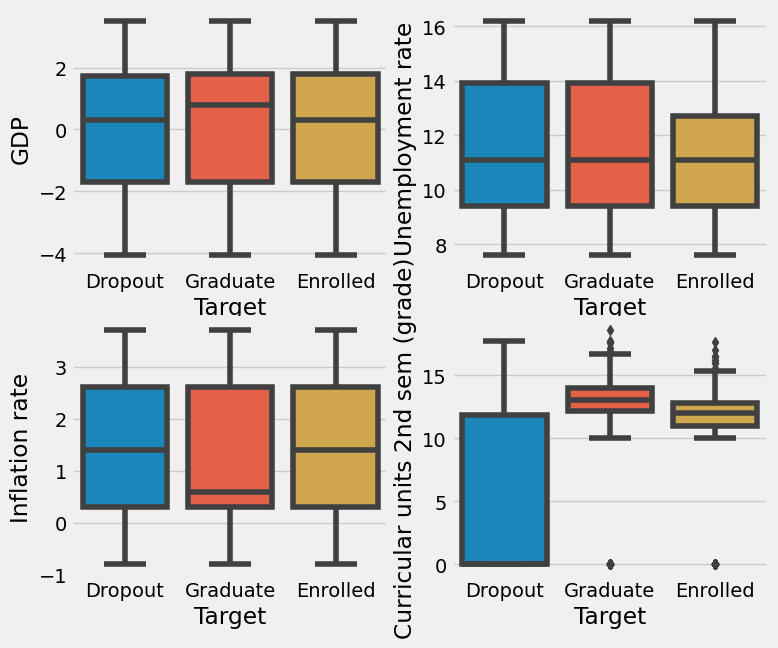

In [30]:
fig, axes = plt.subplots(2, 2, figsize=(8, 7))
sns.boxplot(x=df["Target"], y=df["GDP"], orient='v', ax=axes[0, 0])
sns.boxplot(x=df["Target"], y=df["Unemployment rate"], orient='v', ax=axes[0, 1])
sns.boxplot(x=df["Target"], y=df["Inflation rate"], orient='v', ax=axes[1, 0])
sns.boxplot(x=df["Target"], y=df["Curricular units 2nd sem (grade)"], orient='v', ax=axes[1, 1])

plt.show()

Pisahkan dataset menjadi variabel independen dan variabel dependen

In [31]:
X = df.drop('Target', axis = 1)
Y = df['Target']

print(X.head())
print(Y.head())

   Marital status  Application mode  Application order  Course  \
0               1                17                  5     171   
1               1                15                  1    9254   
2               1                 1                  5    9070   
3               1                17                  2    9773   
4               2                39                  1    8014   

   Daytime/evening attendance  Previous qualification  \
0                           1                       1   
1                           1                       1   
2                           1                       1   
3                           1                       1   
4                           0                       1   

   Previous qualification (grade)  Nacionality  Mother's qualification  \
0                           122.0            1                      19   
1                           160.0            1                       1   
2                           122.0     

In [32]:
lab_enc = LabelEncoder()
df["Target"] = lab_enc.fit_transform(df["Target"])
df.head()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,0
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,2
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,0
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,2
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,2


In [33]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df)
scaled_data

array([[-0.29482875, -0.09547022,  2.49089589, ...,  0.12438647,
         0.76576084, -1.32649743],
       [-0.29482875, -0.20986898, -0.55406775, ..., -1.10522155,
         0.34719942,  0.9253923 ],
       [-0.29482875, -1.01066035,  2.49089589, ...,  0.12438647,
         0.76576084, -1.32649743],
       ...,
       [-0.29482875, -1.01066035, -0.55406775, ..., -1.10522155,
         0.34719942, -1.32649743],
       [-0.29482875, -1.01066035, -0.55406775, ..., -1.46687097,
        -1.37551124,  0.9253923 ],
       [-0.29482875, -0.4958659 , -0.55406775, ...,  1.7879738 ,
        -0.74987207,  0.9253923 ]])

In [34]:
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

df.head()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,0
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,2
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,0
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,2
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,2


# Cluster the data using K-Means

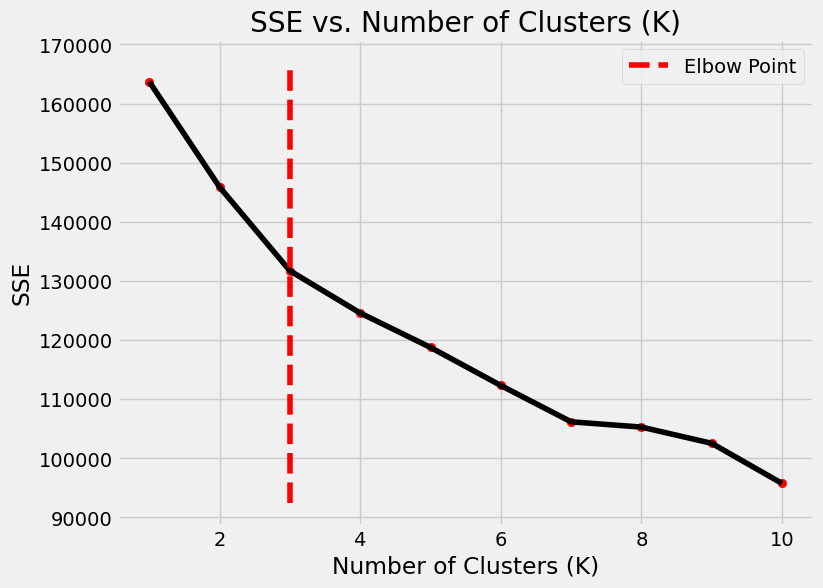

In [35]:
kmeans_kwargs = {"init": "k-means++", "n_init": 10, "max_iter": 300, "random_state": 42}
sse = []

for k in range(1, 11):
    kmeans_model = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans_model.fit(scaled_data)
    sse.append(kmeans_model.inertia_)

knee = KneeLocator(range(1, 11), sse, curve="convex", direction="decreasing")

plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), sse, color='black')
plt.scatter(range(1, 11), sse, color='red')
plt.title('SSE vs. Number of Clusters (K)')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('SSE')
plt.grid(True)

plt.vlines(knee.elbow, plt.ylim()[0], plt.ylim()[1], linestyles='--', colors='red', label='Elbow Point')
plt.legend()
plt.show()

In [36]:
kneed = KneeLocator(range(1,11), sse, curve="convex", direction="decreasing")
print("The best k for you model is", kneed.elbow)

The best k for you model is 3


In [37]:
kmeans = KMeans(n_clusters=4,init="random").fit(scaled_data)
sse.append(kmeans_model.inertia_)
df_kmeans = kmeans.predict(scaled_data)
df["Cluster"]=df_kmeans
df.head()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target,Cluster
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0.000000,0,10.8,1.4,1.74,0,2
1,1,15,1,9254,1,1,160.0,1,1,3,...,6,6,6,13.666667,0,13.9,-0.3,0.79,2,1
2,1,1,5,9070,1,1,122.0,1,37,37,...,6,0,0,0.000000,0,10.8,1.4,1.74,0,2
3,1,17,2,9773,1,1,122.0,1,38,37,...,6,10,5,12.400000,0,9.4,-0.8,-3.12,2,1
4,2,39,1,8014,0,1,100.0,1,37,38,...,6,6,6,13.000000,0,13.9,-0.3,0.79,2,0


In [38]:
k_optimal = 3
kmeans = KMeans(n_clusters=k_optimal, random_state=0)
kmeans.fit(scaled_data)
cluster_assignments = kmeans.labels_

In [39]:
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy='most_frequent')
df.iloc[:,:] = imputer.fit_transform(df)
df.head(5)

,Marital status,Application mode,Application order,Course,Daytime/evening attendance,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target,Cluster
0,1.0,17.0,5.0,171.0,1.0,1.0,122.0,1.0,19.0,12.0,...,0.0,0.0,0.0,0.000000,0.0,10.8,1.4,1.74,0.0,2.0
1,1.0,15.0,1.0,9254.0,1.0,1.0,160.0,1.0,1.0,3.0,...,6.0,6.0,6.0,13.666667,0.0,13.9,-0.3,0.79,2.0,1.0
2,1.0,1.0,5.0,9070.0,1.0,1.0,122.0,1.0,37.0,37.0,...,6.0,0.0,0.0,0.000000,0.0,10.8,1.4,1.74,0.0,2.0
3,1.0,17.0,2.0,9773.0,1.0,1.0,122.0,1.0,38.0,37.0,...,6.0,10.0,5.0,12.400000,0.0,9.4,-0.8,-3.12,2.0,1.0
4,2.0,39.0,1.0,8014.0,0.0,1.0,100.0,1.0,37.0,38.0,...,6.0,6.0,6.0,13.000000,0.0,13.9,-0.3,0.79,2.0,0.0


In [42]:
df.groupby("Cluster")["Target"].agg(pd.Series.mode)

Cluster
0.0    0.0
1.0    2.0
2.0    0.0
3.0    2.0
Name: Target, dtype: float64

In [43]:
featuresMean = ["Marital status", "Application mode", "Application order", "Course", "Daytime/evening attendance",
                    "Previous qualification", "Previous qualification (grade)", "Nacionality",
                    "Father's qualification", "Mother's qualification",
                    "Father's qualification", "Mother's occupation", "Father's occupation", "Admission grade",
                    "Displaced", "Educational special needs", "Debtor", "Tuition fees up to date",
                    "Gender", "Scholarship holder", "Age at enrollment", "International",
                    "Curricular units 1st sem (credited)", "Curricular units 1st sem (enrolled)",
                    "Curricular units 1st sem (evaluations)", "Curricular units 1st sem (approved)",
                    "Curricular units 1st sem (grade)", "Curricular units 1st sem (without evaluations)",
                    "Curricular units 2nd sem (credited)", "Curricular units 2nd sem (enrolled)",
                    "Curricular units 2nd sem (evaluations)", "Curricular units 2nd sem (approved)",
                    "Curricular units 2nd sem (grade)", "Curricular units 2nd sem (without evaluations)",
                    "Unemployment rate", "Inflation rate", "GDP"]

df.groupby("Cluster")[featuresMean].agg(pd.Series.mean)

,Marital status,Application mode,Application order,Course,Daytime/evening attendance,Previous qualification,Previous qualification (grade),Nacionality,Father's qualification,Mother's qualification,...,Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP
Cluster,,,,,,,,,,,,,,,,,,,,,
0.0,1.547619,37.693723,1.057359,9177.849567,0.679654,12.854978,133.067641,1.616883,24.889610,23.769481,...,0.122294,0.593074,6.129870,9.489177,4.231602,11.798270,0.172078,12.118723,1.062879,-0.089556
1.0,1.010284,9.007404,2.083916,9381.030440,0.989716,1.081859,132.529042,1.949815,21.176059,17.612094,...,0.076512,0.030440,6.315919,8.330728,5.373509,12.678494,0.079391,11.405471,1.236281,0.113505
2.0,1.229268,21.673171,1.603659,7251.631707,0.875610,4.229268,132.542317,1.934146,21.985366,20.037805,...,0.243902,0.006098,4.389024,3.573171,0.064634,0.453354,0.291463,11.514634,1.335976,-0.219512
3.0,1.285141,32.506024,1.148594,7830.646586,0.759036,9.140562,131.983936,1.875502,24.261044,21.417671,...,0.441767,7.108434,11.863454,14.947791,10.433735,12.705460,0.297189,11.253815,1.404819,-0.017952


In [44]:
df.groupby("Cluster")["Cluster"].agg(pd.Series.count)

Cluster
0.0     924
1.0    2431
2.0     820
3.0     249
Name: Cluster, dtype: int64

# Cluster the data using Hierarchical Clustering

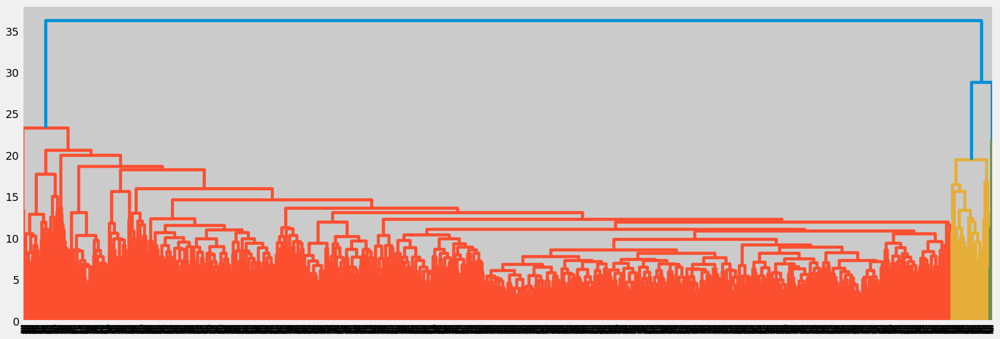

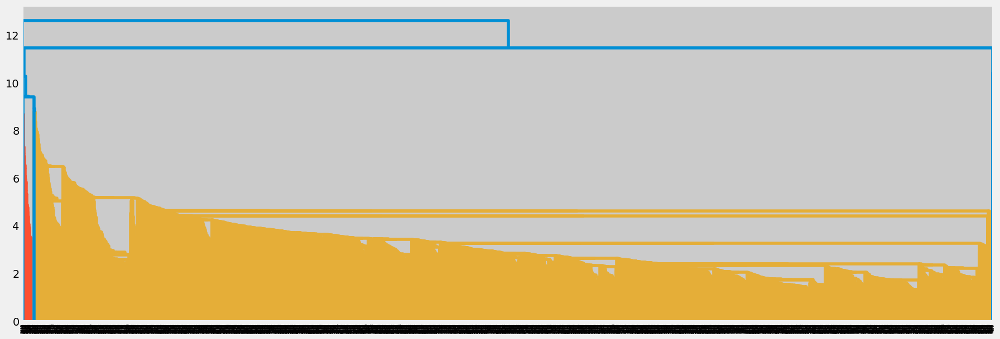

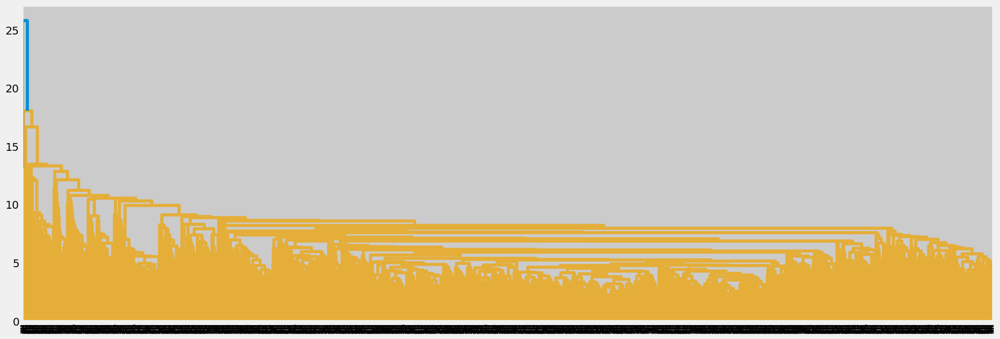

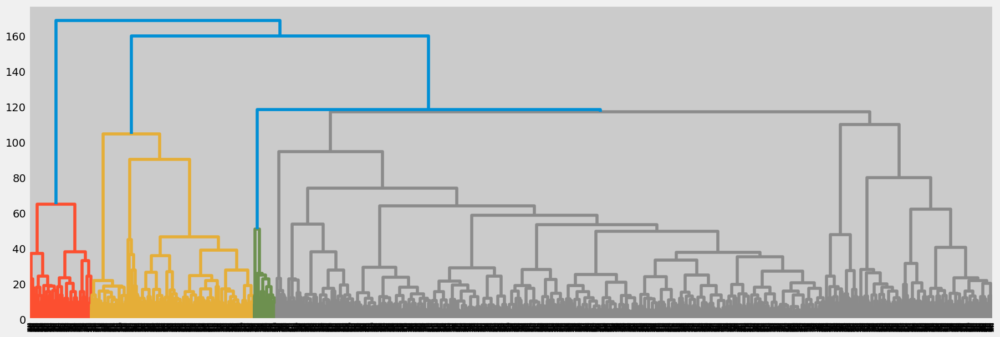

In [74]:
plt.figure(figsize=(20,7))
linkage_data = linkage(scaled_data, method='complete')
dendrogram(linkage_data)
plt.show()

plt.figure(figsize=(20,7))
linkage_data = linkage(scaled_data, method='single')
dendrogram(linkage_data)
plt.show()

plt.figure(figsize=(20,7))
linkage_data = linkage(scaled_data, method='average')
dendrogram(linkage_data)
plt.show()

plt.figure(figsize=(20,7))
linkage_data = linkage(scaled_data, method='ward')
dendrogram(linkage_data)
plt.show()

In [46]:
model = AgglomerativeClustering(n_clusters=4, affinity='euclidean')
label = model.fit_predict(scaled_data)
df["Agglomerative"] = label
print(label)

[2 0 2 ... 0 0 3]


In [47]:
from scipy.cluster.hierarchy import fcluster
hierarchical_clusters = fcluster(linkage_data, k_optimal, criterion='maxclust')

print("Hierarchical Clusters:")
print(hierarchical_clusters)

Hierarchical Clusters:
[2 3 2 ... 3 3 3]


In [48]:
df.groupby("Agglomerative")["Target"].agg(pd.Series.mode)

Agglomerative
0    2.0
1    2.0
2    0.0
3    2.0
Name: Target, dtype: float64

In [49]:
featuresMeanAgglo = ["Marital status", "Application mode", "Application order", "Course", "Daytime/evening attendance",
                    "Previous qualification", "Previous qualification (grade)", "Nacionality",
                    "Father's qualification", "Mother's qualification",
                    "Father's qualification", "Mother's occupation", "Father's occupation", "Admission grade",
                    "Displaced", "Educational special needs", "Debtor", "Tuition fees up to date",
                    "Gender", "Scholarship holder", "Age at enrollment", "International",
                    "Curricular units 1st sem (credited)", "Curricular units 1st sem (enrolled)",
                    "Curricular units 1st sem (evaluations)", "Curricular units 1st sem (approved)",
                    "Curricular units 1st sem (grade)", "Curricular units 1st sem (without evaluations)",
                    "Curricular units 2nd sem (credited)", "Curricular units 2nd sem (enrolled)",
                    "Curricular units 2nd sem (evaluations)", "Curricular units 2nd sem (approved)",
                    "Curricular units 2nd sem (grade)", "Curricular units 2nd sem (without evaluations)",
                    "Unemployment rate", "Inflation rate", "GDP"]

df.groupby("Agglomerative")[featuresMeanAgglo].agg(pd.Series.mean)

,Marital status,Application mode,Application order,Course,Daytime/evening attendance,Previous qualification,Previous qualification (grade),Nacionality,Father's qualification,Mother's qualification,...,Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP
Agglomerative,,,,,,,,,,,,,,,,,,,,,
0,1.178582,16.664740,1.825373,9324.038029,0.902647,4.318223,132.590508,1.007606,22.446912,19.431701,...,0.077274,0.144813,6.212656,8.476118,4.963493,12.171788,0.118649,11.521022,1.197536,0.073435
1,1.296167,33.247387,1.132404,8001.041812,0.752613,7.864111,131.311498,1.456446,24.888502,22.135889,...,0.229965,6.341463,11.139373,14.118467,9.501742,12.615743,0.167247,11.493380,1.466551,-0.215157
2,1.147256,21.891566,1.555556,7156.793842,0.882195,4.670683,132.659170,1.032129,21.688086,19.779116,...,0.362784,0.105756,4.500669,4.004016,0.244980,0.788884,0.297189,11.808434,1.281124,-0.311767
3,1.077670,18.640777,1.524272,8652.912621,0.961165,3.029126,136.635922,36.757282,13.776699,14.970874,...,0.174757,0.213592,5.737864,7.456311,3.873786,10.094639,0.048544,11.451456,1.151456,0.601650


In [50]:
df.groupby("Agglomerative")["Agglomerative"].agg(pd.Series.count)

Agglomerative
0    3287
1     287
2     747
3     103
Name: Agglomerative, dtype: int64

In [51]:
X = df.select_dtypes(include=['int64', 'float64'])

kmeans_kwargs = {"init": "k-means++", "n_init": 10, "max_iter": 300, "random_state": 42}
sse = []

for k in range(1, 11):
    kmeansmodel = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeansmodel.fit(X)
    sse.append(kmeansmodel.inertia_)

knee = KneeLocator(range(1, 11), sse, curve="convex", direction="decreasing")
k_optimal = knee.elbow

kmeans = KMeans(n_clusters=k_optimal, **kmeans_kwargs)
kmeans.fit(X)
label = kmeans.labels_

cluster_summary = df.groupby("Agglomerative").agg('mean').reset_index()

print(cluster_summary)

   Agglomerative  Marital status  Application mode  Application order  \
0              0        1.178582         16.664740           1.825373   
1              1        1.296167         33.247387           1.132404   
2              2        1.147256         21.891566           1.555556   
3              3        1.077670         18.640777           1.524272   

        Course  Daytime/evening attendance  Previous qualification  \
0  9324.038029                    0.902647                4.318223   
1  8001.041812                    0.752613                7.864111   
2  7156.793842                    0.882195                4.670683   
3  8652.912621                    0.961165                3.029126   

   Previous qualification (grade)  Nacionality  Mother's qualification  ...  \
0                      132.590508     1.007606               19.431701  ...   
1                      131.311498     1.456446               22.135889  ...   
2                      132.659170     1.032129

# Prediction Model using Classification Algorithm

## 1. XGBoost

In [52]:
le = LabelEncoder()
y_train = le.fit_transform(y_train)
y_test = le.fit_transform(y_test)

In [53]:
status = ["Dropout [0]" , "Enrolled[1]", "Graduated [2]"]

In [54]:
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split

xgb = XGBClassifier()
xgb.fit(X_train,y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [55]:
y_pred = xgb.predict(X_test)
cm = confusion_matrix(y_test, y_pred)

accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy XGBoost: {accuracy}')
xgb_test_acc = accuracy_score(y_test, y_pred)

Accuracy XGBoost: 0.7694915254237288


## 2. KNN

In [56]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors = 5, metric="euclidean", p=2)
knn.fit(X_train,y_train)

KNeighborsClassifier(metric='euclidean')

In [57]:
status = ["Dropout [0]" , "Enrolled[1]", "Graduated [2]"]

In [58]:
y_pred = knn.predict(X_test)
cm = confusion_matrix(y_test, y_pred)

accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy KNN: {accuracy}')
knn_test_acc = accuracy_score(y_test, y_pred)

Accuracy KNN: 0.7016949152542373


## 3. Logistic Regression

In [59]:
X = df.drop(['Target'], axis = 1)
Y = df['Target']

In [60]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X)
scaler_transformed = scaler.transform(X)
scaler_transformed

array([[-0.29482875, -0.09547022,  2.49089589, ...,  0.76576084,
         1.16498689,  1.79202784],
       [-0.29482875, -0.20986898, -0.55406775, ...,  0.34719942,
        -0.11389698, -0.55420808],
       [-0.29482875, -1.01066035,  2.49089589, ...,  0.76576084,
         1.16498689,  1.79202784],
       ...,
       [-0.29482875, -1.01066035, -0.55406775, ...,  0.34719942,
        -0.11389698, -0.55420808],
       [-0.29482875, -1.01066035, -0.55406775, ..., -1.37551124,
        -0.11389698, -0.55420808],
       [-0.29482875, -0.4958659 , -0.55406775, ..., -0.74987207,
        -0.11389698,  2.96514579]])

In [61]:
logreg = LogisticRegression()
logreg.fit(X_train,y_train)

LogisticRegression()

In [62]:
status = ["Dropout [0]" , "Enrolled[1]", "Graduated [2]"]

In [63]:
y_pred = logreg.predict(X_test)
cm = confusion_matrix(y_test, y_pred)

accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy Logistic Regression: {accuracy}')
logreg_test_acc = accuracy_score(y_test, y_pred)

Accuracy Logistic Regression: 0.752542372881356


## 4. Gaussian Naive Bayes

In [64]:
gnb = GaussianNB()
gnb.fit(X_train,y_train)

GaussianNB()

In [65]:
status = ["Dropout [0]" , "Enrolled[1]", "Graduated [2]"]

In [66]:
y_pred = gnb.predict(X_test)
cm = confusion_matrix(y_test, y_pred)

accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy Gaussian Naive Bayes: {accuracy}')
gnb_test_acc = accuracy_score(y_test, y_pred)

Accuracy Gaussian Naive Bayes: 0.6926553672316385


## 5. Decision Tree

In [67]:
DT = DecisionTreeClassifier()
DT.fit(X_train,y_train)

DecisionTreeClassifier()

In [68]:
status = ["Dropout [0]" , "Enrolled[1]", "Graduated [2]"]

In [69]:
y_pred = DT.predict(X_test)
cm = confusion_matrix(y_test, y_pred)

accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy Decision Tree: {accuracy}')
DT_test_acc = accuracy_score(y_test, y_pred)

Accuracy Decision Tree: 0.6813559322033899


## 6. Random Forest

In [70]:
rdm_frst = RandomForestClassifier(n_estimators=100)
rdm_frst.fit(X_train,y_train)

RandomForestClassifier()

In [71]:
status = ["Dropout [0]" , "Enrolled[1]", "Graduated [2]"]

In [72]:
y_pred = rdm_frst.predict(X_test)
cm = confusion_matrix(y_test, y_pred)

accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy Random Forest: {accuracy}')
rdm_test_acc = accuracy_score(y_test, y_pred)

Accuracy Random Forest: 0.7638418079096045


# Prediction Model Comparison Results

In [73]:
model_names = [
    'Logistic Regression', 'K-Nearest Neighbors', 'XGBoost',
    'Gaussian Naive Bayes', 'Decision Tree', 'Random Forest'
]

model_accuracy_scores = [
    xgb_test_acc, knn_test_acc, logreg_test_acc, gnb_test_acc, DT_test_acc, rdm_test_acc
]

models = pd.DataFrame({
    'Model': model_names,
    'Model Accuracy Score': model_accuracy_scores
})

sorted_models = models.sort_values(by='Model Accuracy Score', ascending=False)
styled_models = sorted_models.style.background_gradient(cmap='coolwarm')

styled_models

,Model,Model Accuracy Score
0,Logistic Regression,0.769492
5,Random Forest,0.763842
2,XGBoost,0.752542
1,K-Nearest Neighbors,0.701695
3,Gaussian Naive Bayes,0.692655
4,Decision Tree,0.681356


# Conclusion
- The classification algorithms evaluated (Logistic Regression, Random Forest, XGBoost, K-Nearest Neighbors, Gaussian Naive Bayes, Decision Tree) are well-suited for this dataset, considering the target variable's discrete nature with values limited to 'enrolled,' 'graduated,' and 'dropout.'

- Logistic Regression emerged as the top-performing model, achieving the highest accuracy score of 0.769492. This result indicates its effectiveness in making accurate predictions on the dataset.

- Random Forest closely follows Logistic Regression with an accuracy score of 0.763842, demonstrating its strong predictive capabilities.

- XGBoost, while still a competitive choice, achieved a slightly lower accuracy score of 0.752542 compared to Logistic Regression and Random Forest.

- K-Nearest Neighbors, Gaussian Naive Bayes, and Decision Tree exhibited lower accuracy scores, with K-Nearest Neighbors being the most accurate among them.

- This dataset's nature, characterized by a discrete target variable and the absence of continuous values, aligns well with the strengths of classification algorithms. These models prove to be valuable tools for making predictions and informed decisions.

- In summary, Logistic Regression stands out as the most accurate model, closely followed by Random Forest. The choice between these models may depend on factors such as interpretability, computational efficiency, and specific requirements of the problem at hand.
